### **Import HF transformer pipeline**

In [ ]:

from transformers import pipeline
generator = pipeline("mask-generation", model="facebook/sam-vit-huge", device=0)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/2.56G [00:00<?, ?B/s]

Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Device set to use cuda:0


In [ ]:
PIXEL_SIZE_UM = 0.5  # Change this to match your calibration

def calculate_grain_areas(masks, pixel_size_um=PIXEL_SIZE_UM):
    """Calculate area and basic metrics for each mask"""
    grain_data = []

    for i, mask in enumerate(masks):
        if len(mask.shape) > 2:
            mask_2d = mask.reshape(mask.shape[-2], mask.shape[-1])
        else:
            mask_2d = mask

        area_pixels = np.sum(mask_2d > 0)
        area_um2 = area_pixels * (pixel_size_um ** 2)

        if area_pixels > 50:
            diameter_um = 2 * np.sqrt(area_um2 / np.pi)

            moments = cv2.moments(mask_2d.astype(np.uint8))
            if moments['m00'] != 0:
                cx = int(moments['m10'] / moments['m00'])
                cy = int(moments['m01'] / moments['m00'])
            else:
                cx, cy = 0, 0

            grain_data.append({
                'grain_id': i + 1,
                'area_pixels': area_pixels,
                'area_um2': area_um2,
                'diameter_um': diameter_um,
                'centroid_x': cx,
                'centroid_y': cy
            })

    return grain_data

def get_statistics(grain_data):
    """Calculate summary statistics"""
    if not grain_data:
        return {}

    areas = [g['area_um2'] for g in grain_data]
    diameters = [g['diameter_um'] for g in grain_data]

    stats = {
        'total_grains': len(grain_data),
        'total_area_um2': sum(areas),
        'mean_area_um2': np.mean(areas),
        'std_area_um2': np.std(areas),
        'min_area_um2': min(areas),
        'max_area_um2': max(areas),
        'mean_diameter_um': np.mean(diameters),
        'std_diameter_um': np.std(diameters)
    }
    return stats

def show_mask(mask, ax, random_color=False, grain_info=None):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

    if grain_info:
        cx, cy = grain_info['centroid_x'], grain_info['centroid_y']
        area = grain_info['area_um2']
        ax.text(cx, cy, f'{area:.0f}μm²', ha='center', va='center',
                fontsize=6, color='white', weight='bold',
                bbox=dict(boxstyle="round,pad=0.1", facecolor='black', alpha=0.7))

    del mask
    gc.collect()

def show_masks_on_image(raw_image, masks, path, pixel_size_um=PIXEL_SIZE_UM):
    grain_data = calculate_grain_areas(masks, pixel_size_um)
    stats = get_statistics(grain_data)

    plt.figure(figsize=(12, 8))
    plt.imshow(np.array(raw_image))
    ax = plt.gca()
    ax.set_autoscale_on(False)

    for i, mask in enumerate(masks):
        grain_info = None
        for grain in grain_data:
            if grain['grain_id'] == i + 1:
                grain_info = grain
                break

        show_mask(mask, ax=ax, random_color=True, grain_info=grain_info)

    if stats:
        title = f"Grains: {stats['total_grains']}, Mean area: {stats['mean_area_um2']:.1f}±{stats['std_area_um2']:.1f} μm²"
        plt.title(title, fontsize=10, pad=10)

    basename = os.path.basename(path)
    name = os.path.splitext(basename)[0]
    plt.axis("off")
    fn = os.path.join('/content/masked_n1/', name + "_with_areas.png")
    plt.savefig(fn, bbox_inches='tight', pad_inches=0, dpi=300)
    plt.show()

    if stats:
        print(f"\n--- {name} Analysis ---")
        print(f"Total grains: {stats['total_grains']}")
        print(f"Mean area: {stats['mean_area_um2']:.1f} ± {stats['std_area_um2']:.1f} μm²")
        print(f"Area range: {stats['min_area_um2']:.1f} - {stats['max_area_um2']:.1f} μm²")
        print(f"Mean diameter: {stats['mean_diameter_um']:.1f} ± {stats['std_diameter_um']:.1f} μm")

    if grain_data:
        csv_path = os.path.join('/content/masked_n1/', name + "_grain_data.csv")
        df = pd.DataFrame(grain_data)
        df.to_csv(csv_path, index=False)
        print(f"Grain data saved: {csv_path}")

    del mask
    gc.collect()

    return grain_data, stats


Processing 60 images with pixel size: 0.5 μm/pixel

Processing batch 1: 4 images


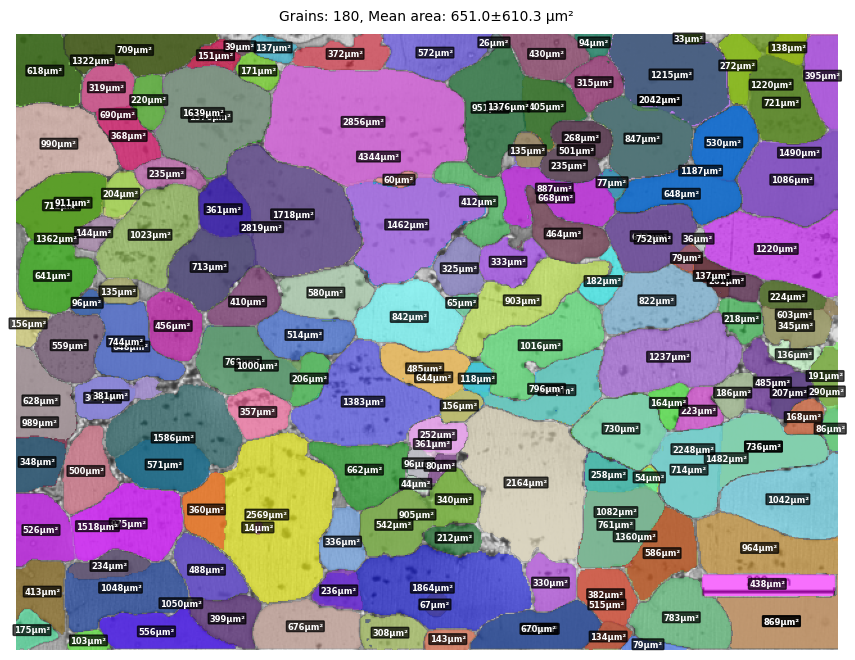


--- image0053 Analysis ---
Total grains: 180
Mean area: 651.0 ± 610.3 μm²
Area range: 14.2 - 4343.8 μm²
Mean diameter: 26.1 ± 12.1 μm
Grain data saved: /content/masked_n1/image0053_grain_data.csv


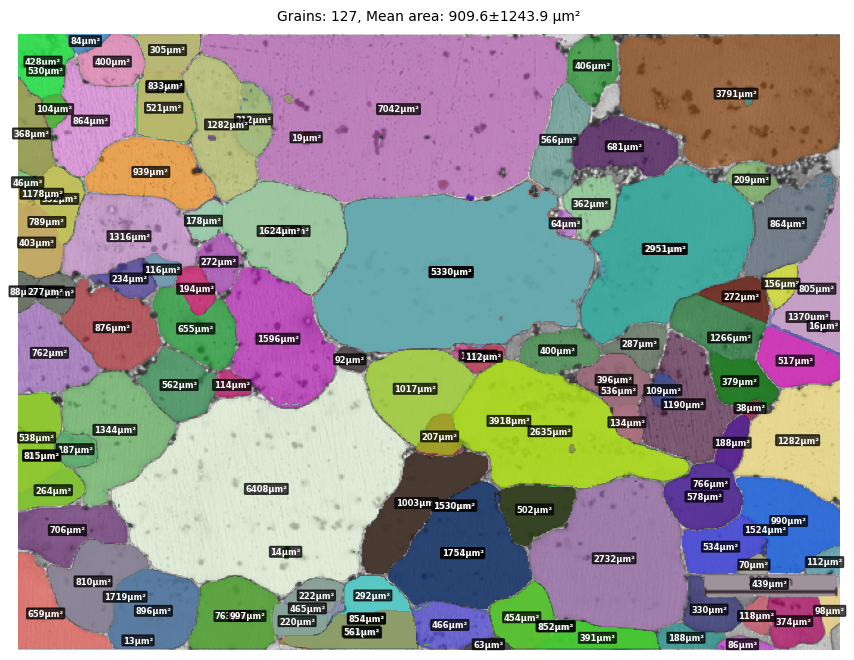


--- image0095 Analysis ---
Total grains: 127
Mean area: 909.6 ± 1243.9 μm²
Area range: 13.0 - 7041.5 μm²
Mean diameter: 29.0 ± 17.8 μm
Grain data saved: /content/masked_n1/image0095_grain_data.csv


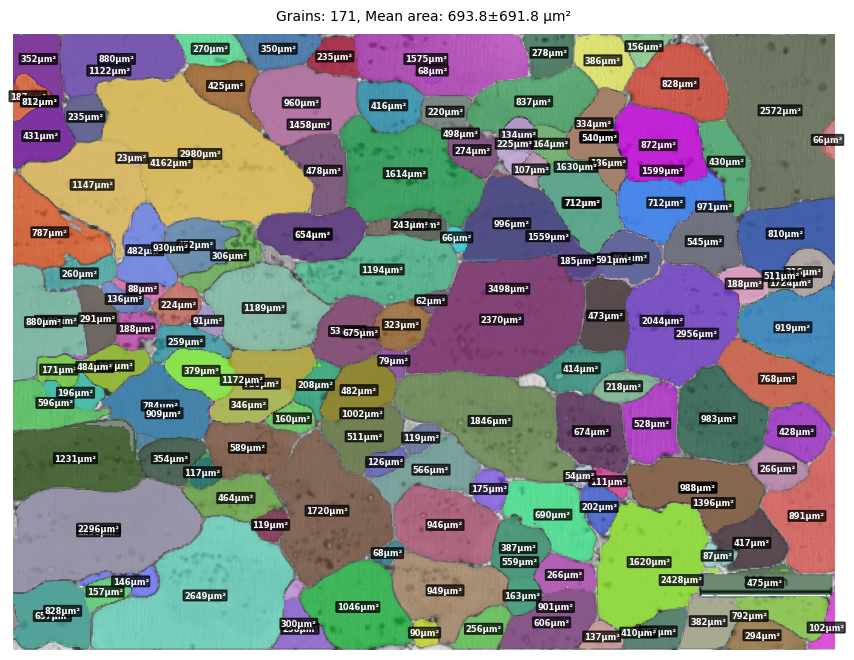


--- image0054 Analysis ---
Total grains: 171
Mean area: 693.8 ± 691.8 μm²
Area range: 23.2 - 4162.2 μm²
Mean diameter: 26.8 ± 12.9 μm
Grain data saved: /content/masked_n1/image0054_grain_data.csv


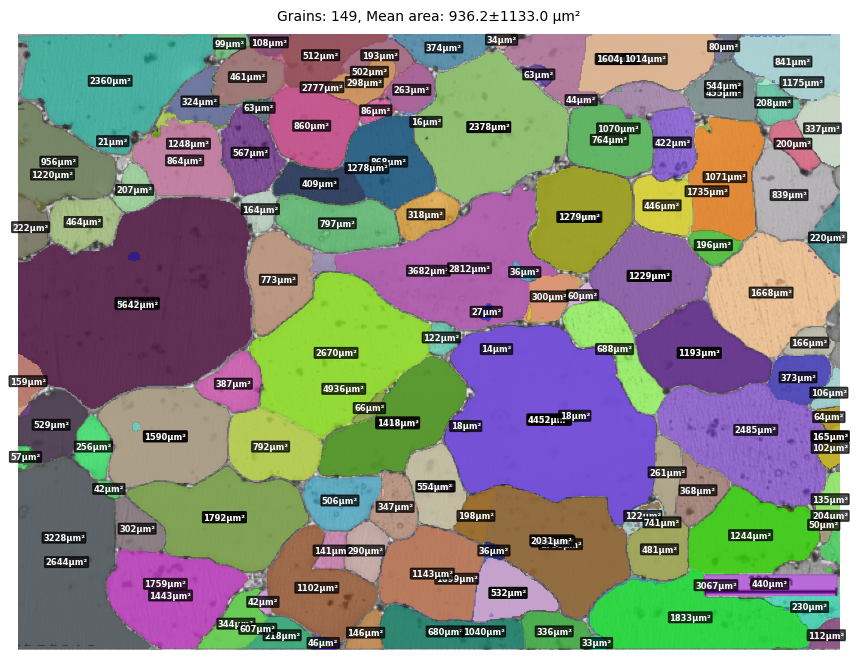


--- image0050 Analysis ---
Total grains: 149
Mean area: 936.2 ± 1133.0 μm²
Area range: 13.5 - 5641.8 μm²
Mean diameter: 29.2 ± 18.4 μm
Grain data saved: /content/masked_n1/image0050_grain_data.csv

Processing batch 2: 4 images


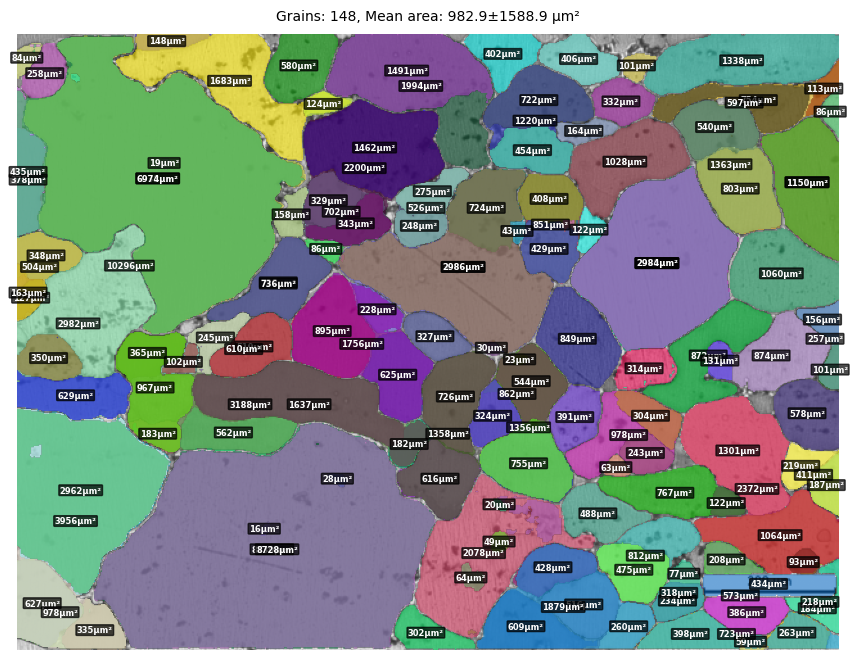


--- image0093 Analysis ---
Total grains: 148
Mean area: 982.9 ± 1588.9 μm²
Area range: 15.5 - 10295.8 μm²
Mean diameter: 29.3 ± 19.8 μm
Grain data saved: /content/masked_n1/image0093_grain_data.csv


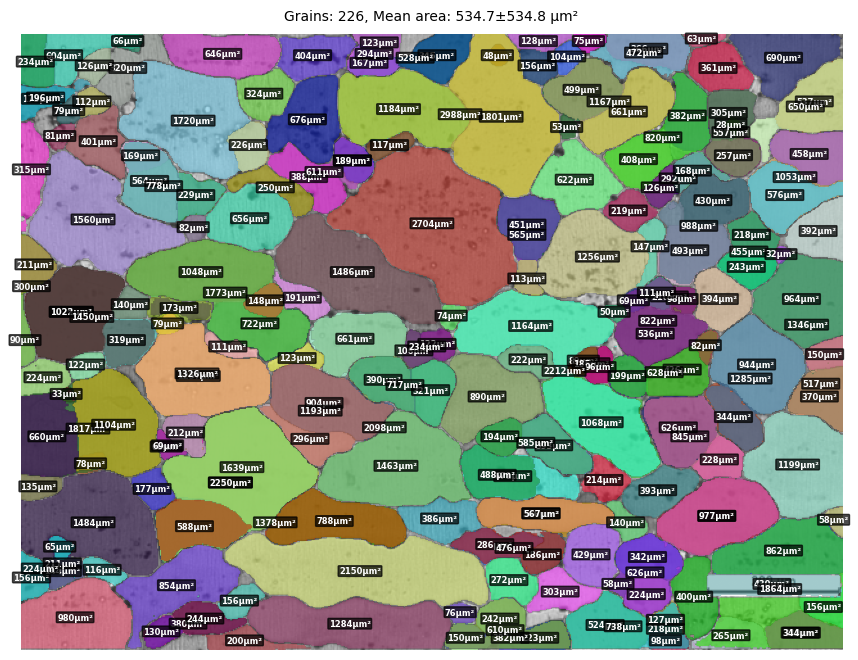


--- image0057 Analysis ---
Total grains: 226
Mean area: 534.7 ± 534.8 μm²
Area range: 28.5 - 2988.2 μm²
Mean diameter: 23.4 ± 11.6 μm
Grain data saved: /content/masked_n1/image0057_grain_data.csv


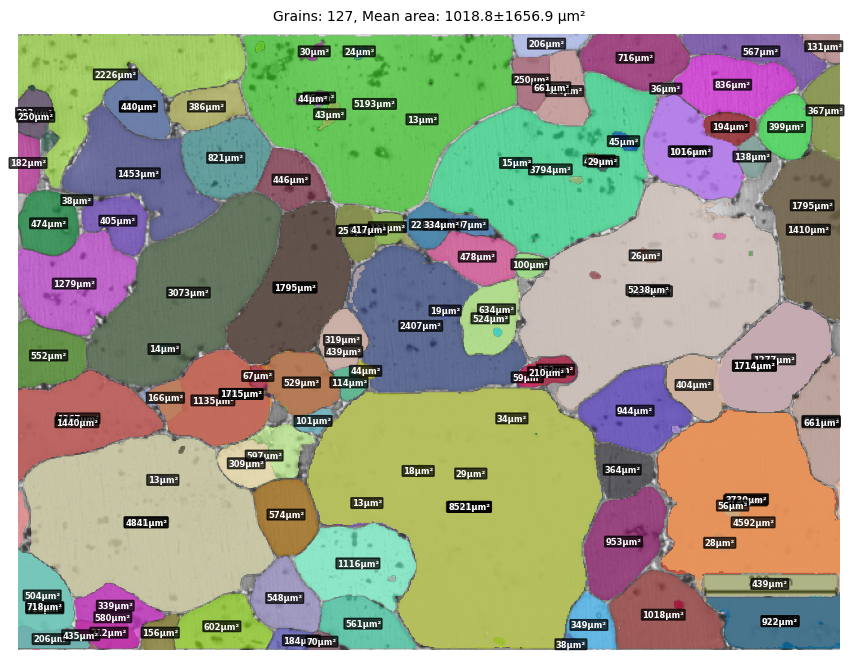


--- image0064 Analysis ---
Total grains: 127
Mean area: 1018.8 ± 1656.9 μm²
Area range: 13.0 - 8520.8 μm²
Mean diameter: 28.4 ± 22.2 μm
Grain data saved: /content/masked_n1/image0064_grain_data.csv


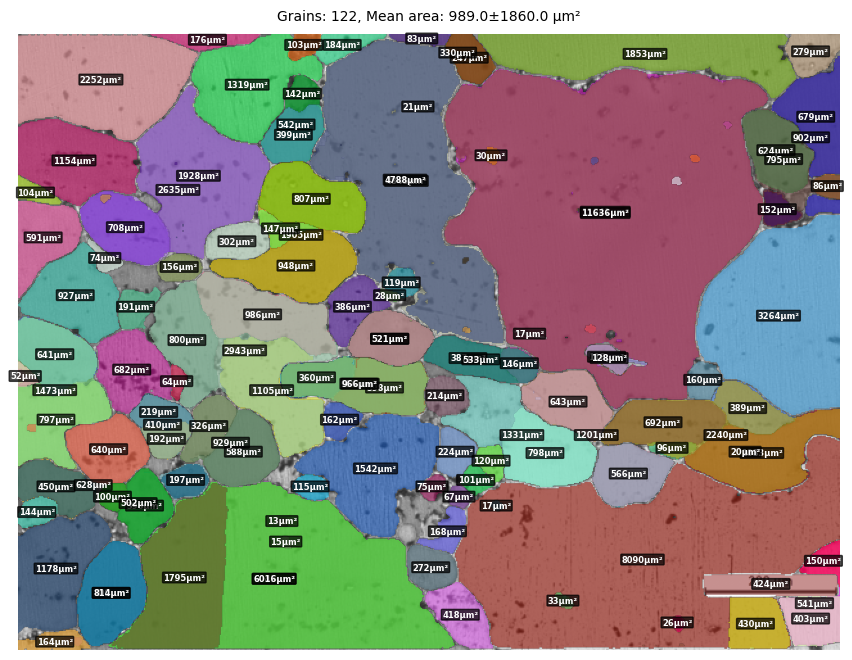


--- image0080 Analysis ---
Total grains: 122
Mean area: 989.0 ± 1860.0 μm²
Area range: 13.2 - 11641.2 μm²
Mean diameter: 28.0 ± 21.7 μm
Grain data saved: /content/masked_n1/image0080_grain_data.csv

Processing batch 3: 4 images


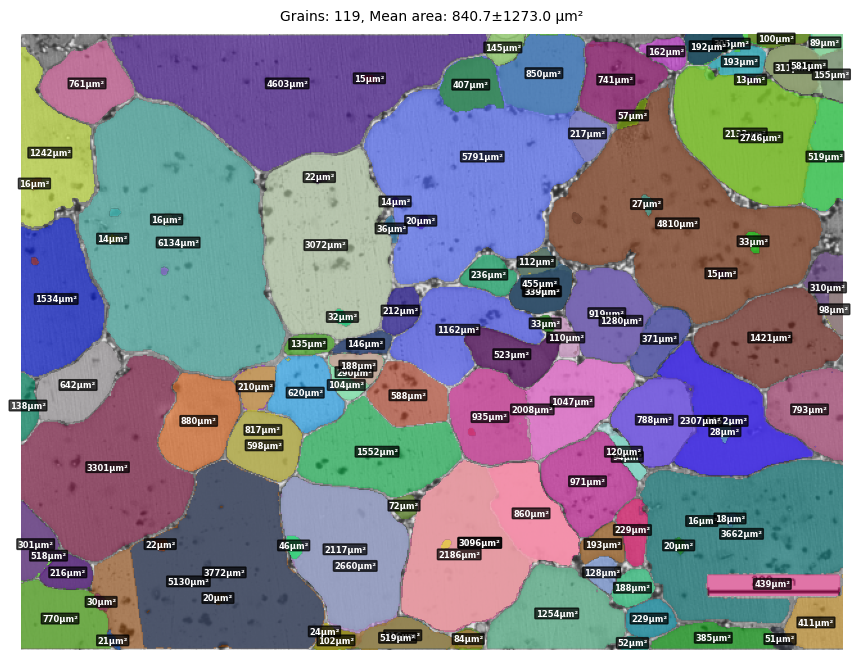


--- image0066 Analysis ---
Total grains: 119
Mean area: 840.7 ± 1273.0 μm²
Area range: 13.0 - 6133.8 μm²
Mean diameter: 25.6 ± 20.4 μm
Grain data saved: /content/masked_n1/image0066_grain_data.csv


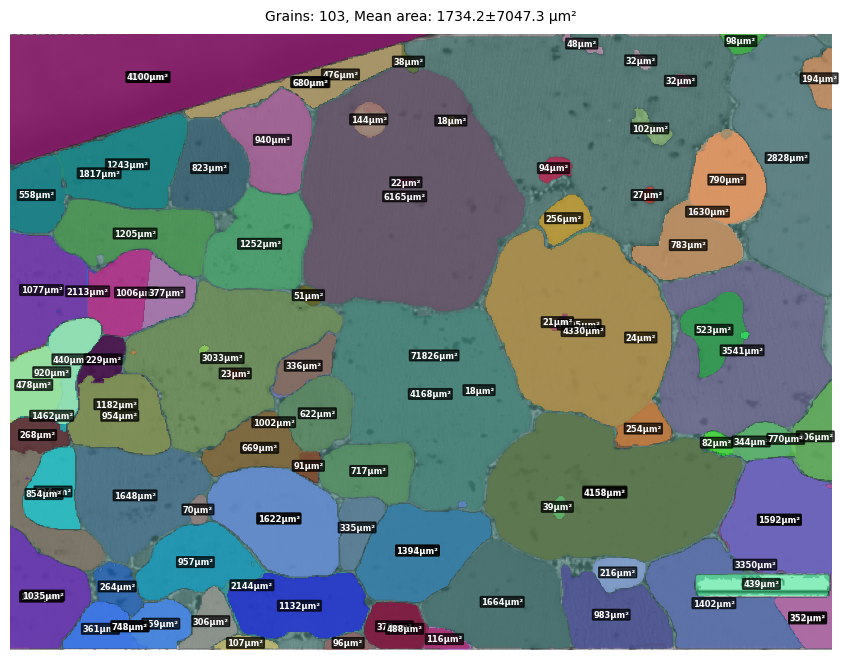


--- image0049 Analysis ---
Total grains: 103
Mean area: 1734.2 ± 7047.3 μm²
Area range: 17.5 - 71826.5 μm²
Mean diameter: 33.6 ± 32.8 μm
Grain data saved: /content/masked_n1/image0049_grain_data.csv


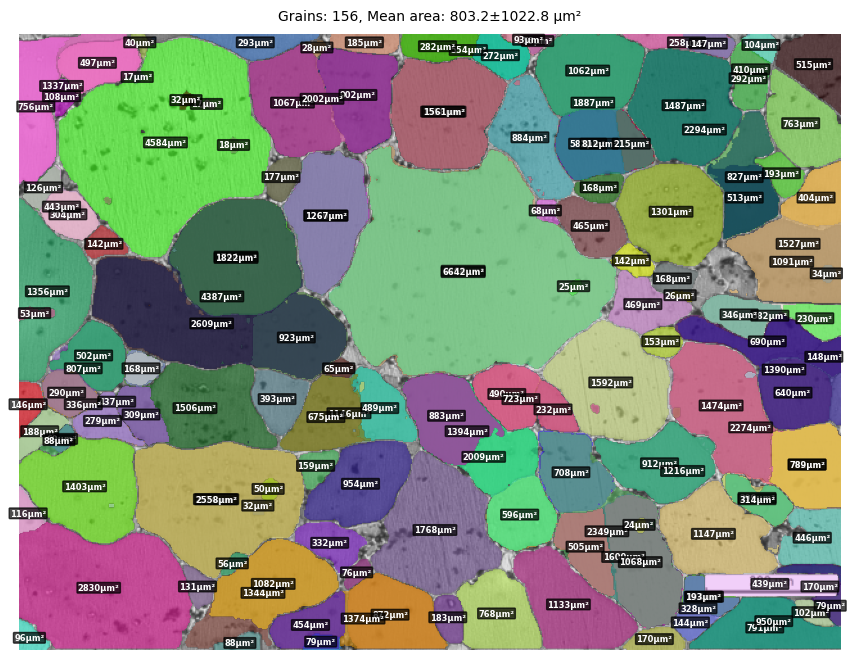


--- image0099 Analysis ---
Total grains: 156
Mean area: 803.2 ± 1022.8 μm²
Area range: 16.8 - 6668.0 μm²
Mean diameter: 27.3 ± 16.6 μm
Grain data saved: /content/masked_n1/image0099_grain_data.csv


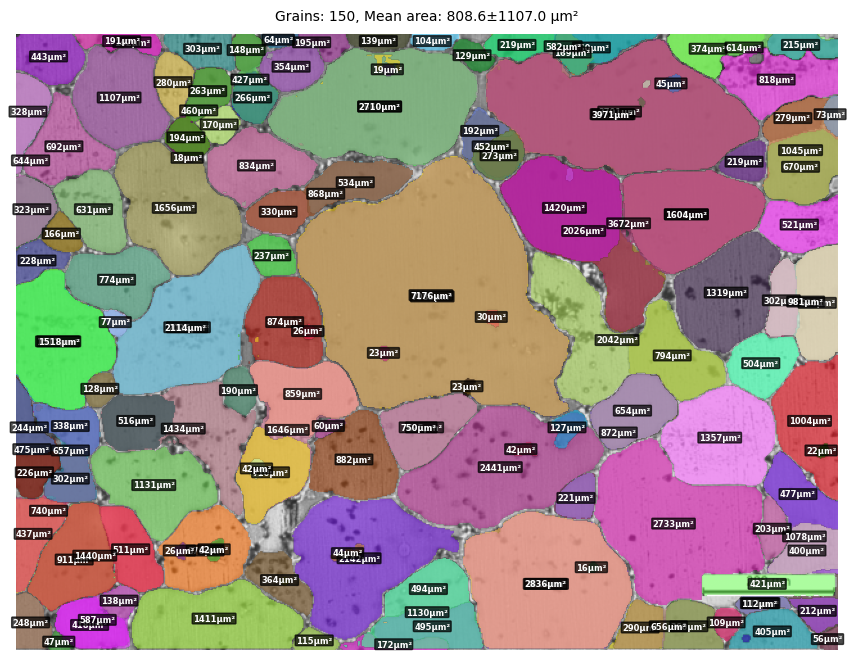


--- image0060 Analysis ---
Total grains: 150
Mean area: 808.6 ± 1107.0 μm²
Area range: 16.0 - 7175.5 μm²
Mean diameter: 27.1 ± 17.2 μm
Grain data saved: /content/masked_n1/image0060_grain_data.csv

Processing batch 4: 4 images


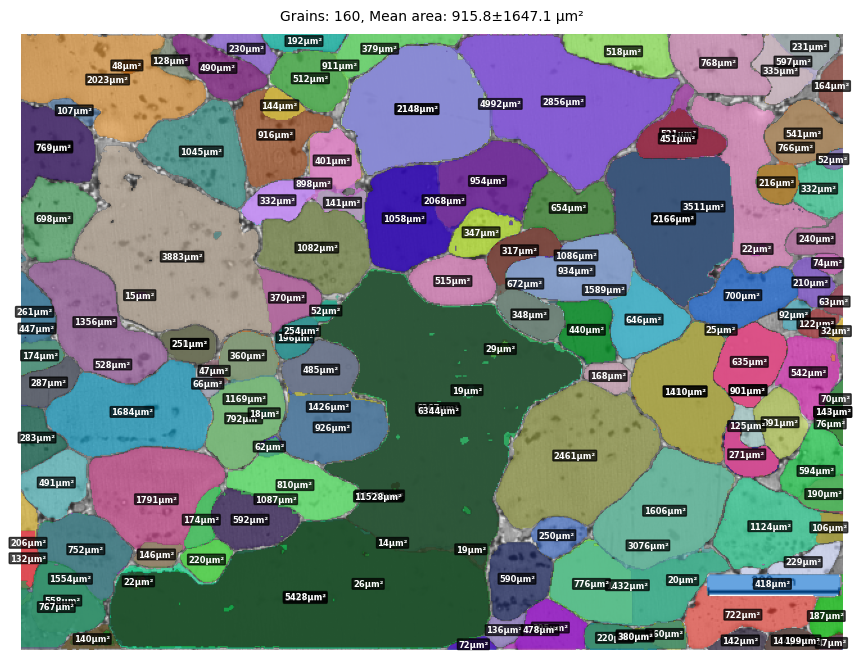


--- image0065 Analysis ---
Total grains: 160
Mean area: 915.8 ± 1647.1 μm²
Area range: 14.2 - 11732.0 μm²
Mean diameter: 27.5 ± 20.3 μm
Grain data saved: /content/masked_n1/image0065_grain_data.csv


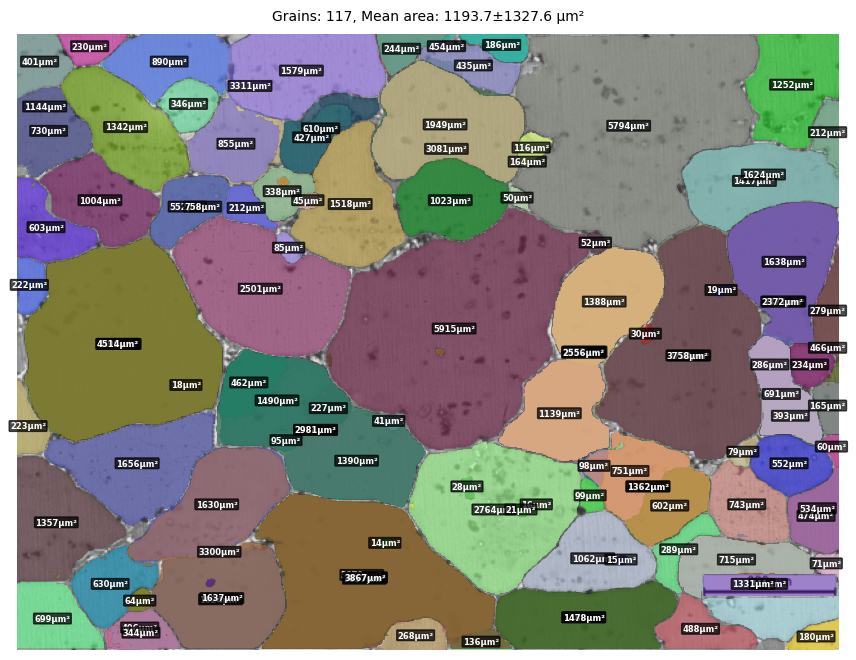


--- image0062 Analysis ---
Total grains: 117
Mean area: 1193.7 ± 1327.6 μm²
Area range: 14.5 - 5915.2 μm²
Mean diameter: 33.1 ± 20.6 μm
Grain data saved: /content/masked_n1/image0062_grain_data.csv


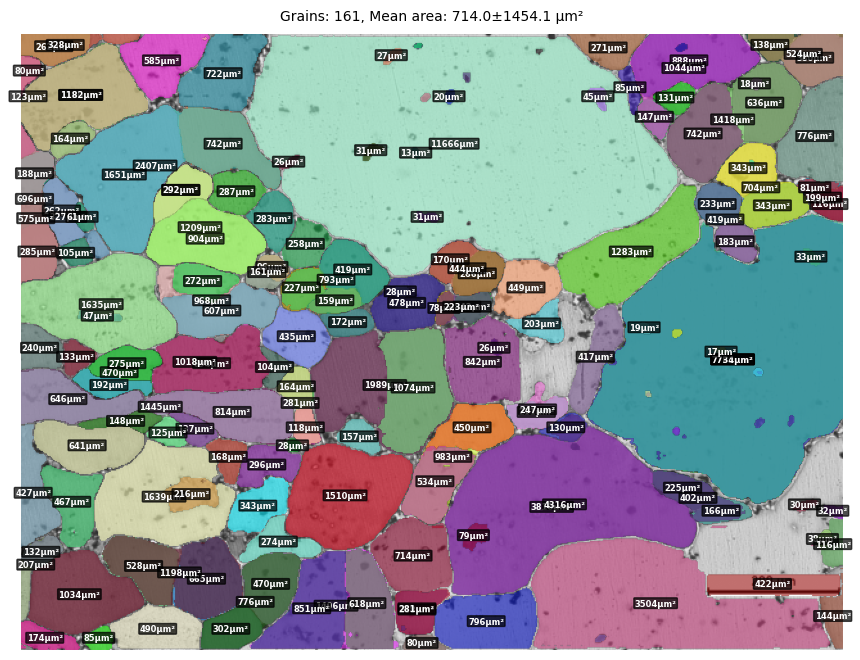


--- image0074 Analysis ---
Total grains: 161
Mean area: 714.0 ± 1454.1 μm²
Area range: 12.8 - 11666.5 μm²
Mean diameter: 24.1 ± 18.1 μm
Grain data saved: /content/masked_n1/image0074_grain_data.csv


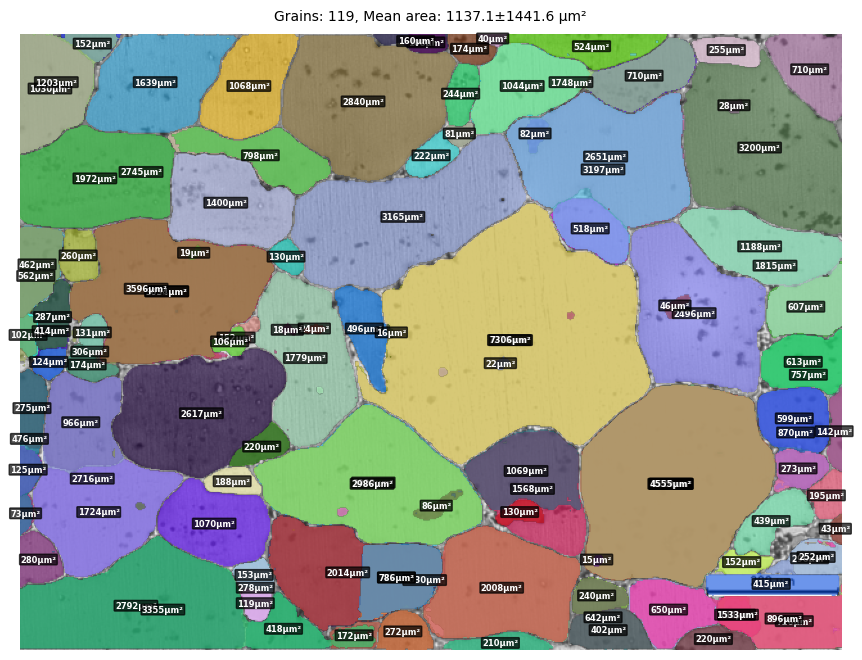


--- image0084 Analysis ---
Total grains: 119
Mean area: 1137.1 ± 1441.6 μm²
Area range: 15.0 - 7305.5 μm²
Mean diameter: 31.5 ± 21.4 μm
Grain data saved: /content/masked_n1/image0084_grain_data.csv

Processing batch 5: 4 images


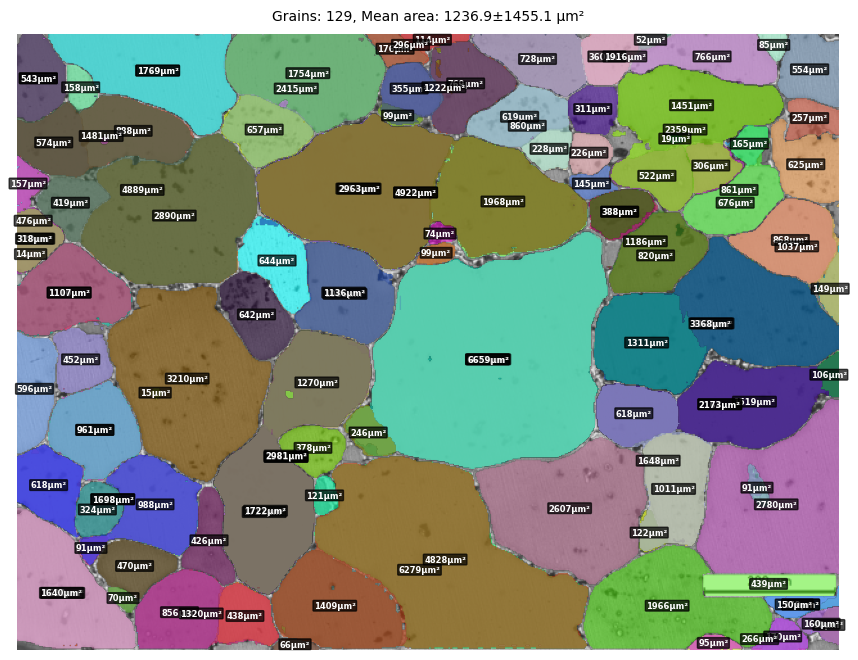


--- image0072 Analysis ---
Total grains: 129
Mean area: 1236.9 ± 1455.1 μm²
Area range: 13.8 - 6673.2 μm²
Mean diameter: 34.0 ± 20.5 μm
Grain data saved: /content/masked_n1/image0072_grain_data.csv


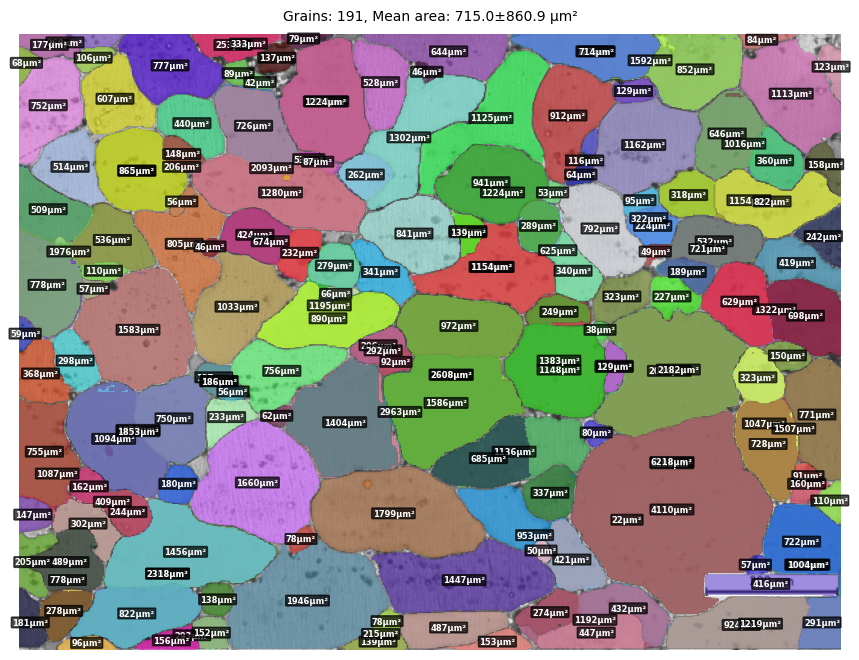


--- image0091 Analysis ---
Total grains: 191
Mean area: 715.0 ± 860.9 μm²
Area range: 22.2 - 6218.5 μm²
Mean diameter: 26.3 ± 14.8 μm
Grain data saved: /content/masked_n1/image0091_grain_data.csv


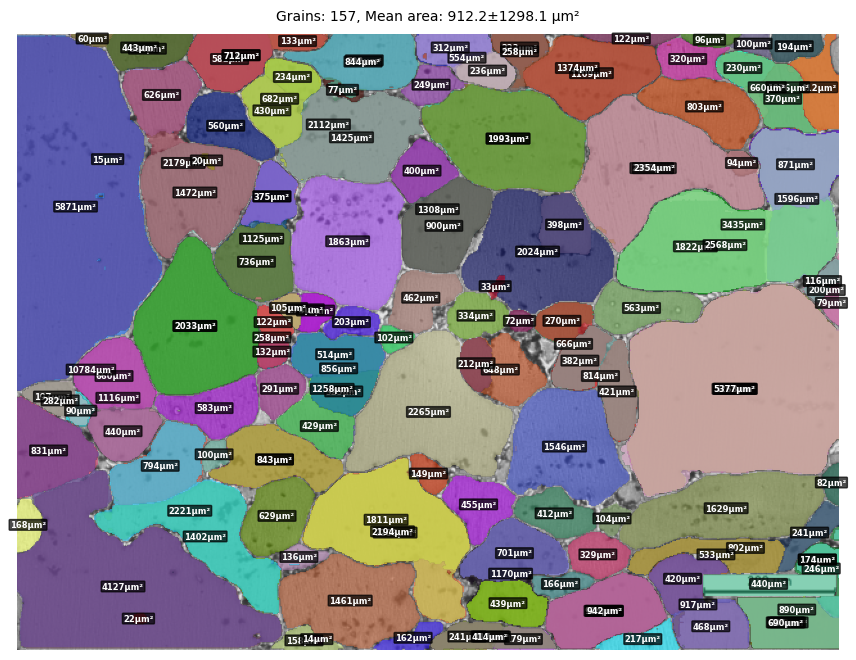


--- image0094 Analysis ---
Total grains: 157
Mean area: 912.2 ± 1298.1 μm²
Area range: 13.8 - 10783.8 μm²
Mean diameter: 29.1 ± 17.7 μm
Grain data saved: /content/masked_n1/image0094_grain_data.csv


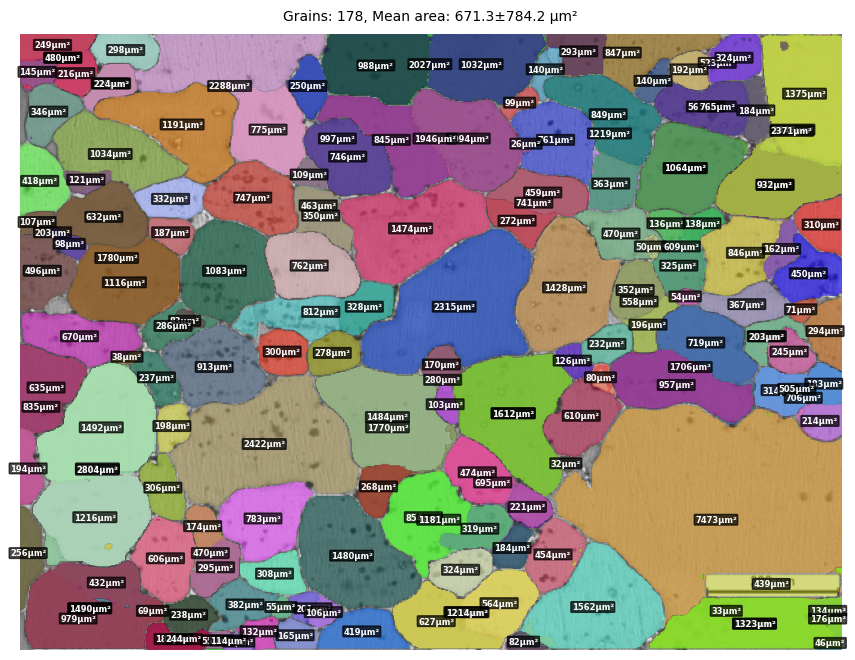


--- image0046 Analysis ---
Total grains: 178
Mean area: 671.3 ± 784.2 μm²
Area range: 25.5 - 7473.2 μm²
Mean diameter: 25.9 ± 13.5 μm
Grain data saved: /content/masked_n1/image0046_grain_data.csv

Processing batch 6: 4 images


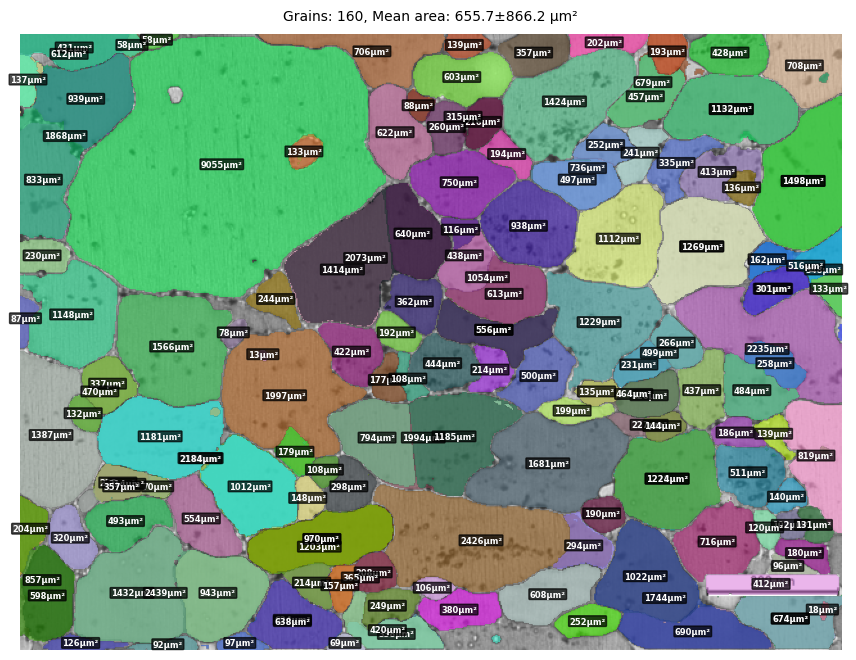


--- image0058 Analysis ---
Total grains: 160
Mean area: 655.7 ± 866.2 μm²
Area range: 13.0 - 9054.8 μm²
Mean diameter: 25.6 ± 13.5 μm
Grain data saved: /content/masked_n1/image0058_grain_data.csv


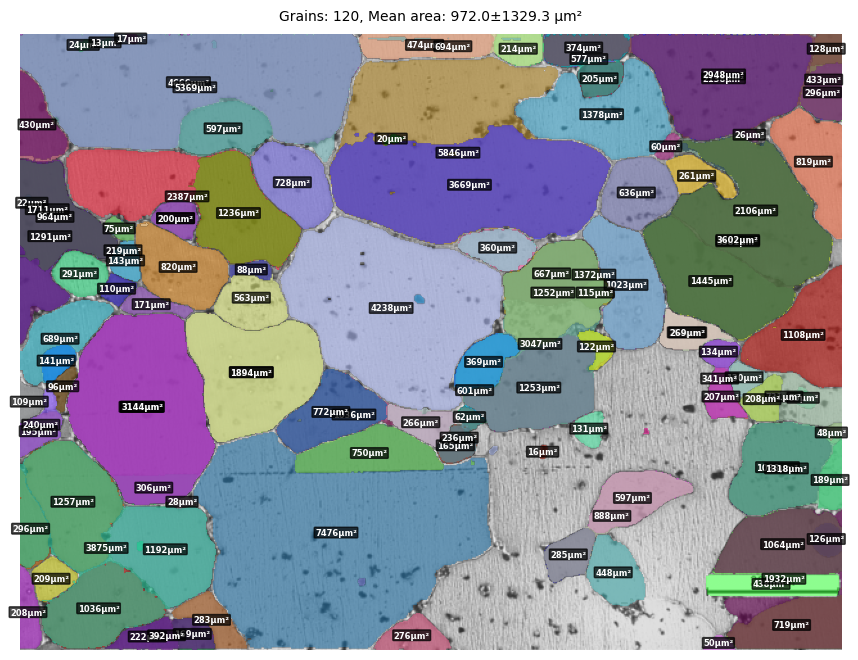


--- image0068 Analysis ---
Total grains: 120
Mean area: 972.0 ± 1329.3 μm²
Area range: 13.2 - 7476.2 μm²
Mean diameter: 29.1 ± 19.8 μm
Grain data saved: /content/masked_n1/image0068_grain_data.csv


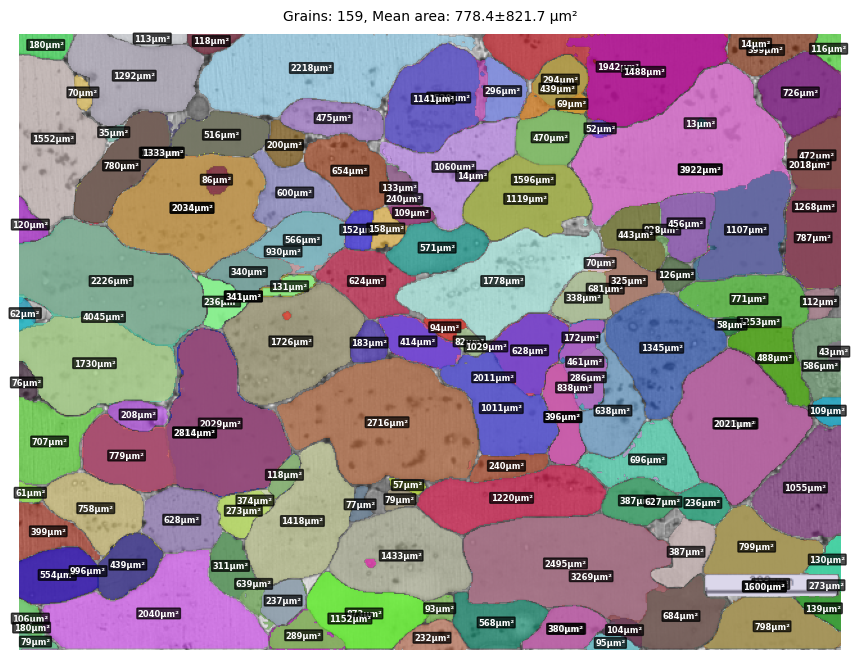


--- image0087 Analysis ---
Total grains: 159
Mean area: 778.4 ± 821.7 μm²
Area range: 13.2 - 4045.2 μm²
Mean diameter: 27.5 ± 15.3 μm
Grain data saved: /content/masked_n1/image0087_grain_data.csv


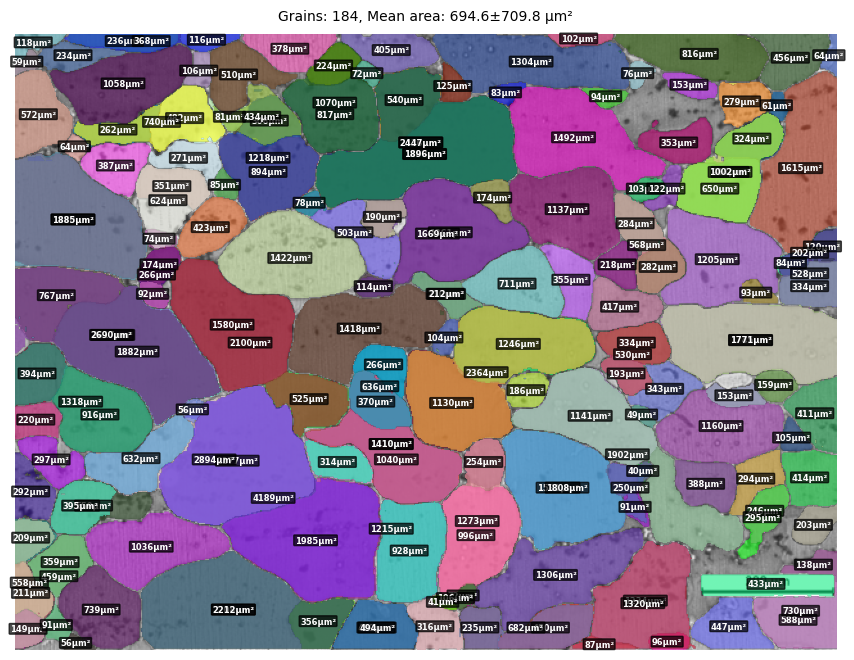


--- image0059 Analysis ---
Total grains: 184
Mean area: 694.6 ± 709.8 μm²
Area range: 40.2 - 4188.8 μm²
Mean diameter: 26.3 ± 13.9 μm
Grain data saved: /content/masked_n1/image0059_grain_data.csv

Processing batch 7: 4 images


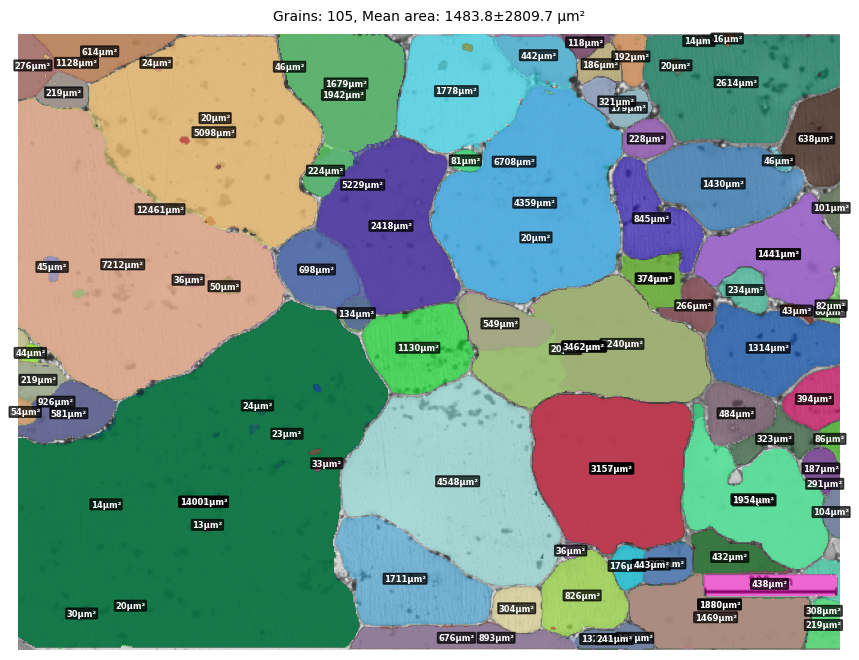


--- image0067 Analysis ---
Total grains: 105
Mean area: 1483.8 ± 2809.7 μm²
Area range: 13.2 - 14001.2 μm²
Mean diameter: 31.9 ± 29.5 μm
Grain data saved: /content/masked_n1/image0067_grain_data.csv


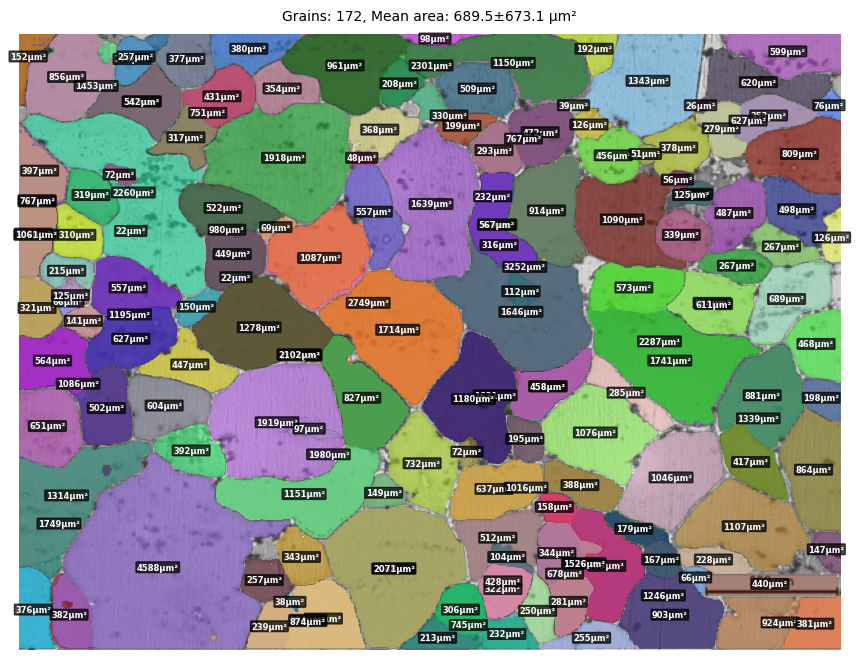


--- image0044 Analysis ---
Total grains: 172
Mean area: 689.5 ± 673.1 μm²
Area range: 21.5 - 4588.0 μm²
Mean diameter: 26.7 ± 12.9 μm
Grain data saved: /content/masked_n1/image0044_grain_data.csv


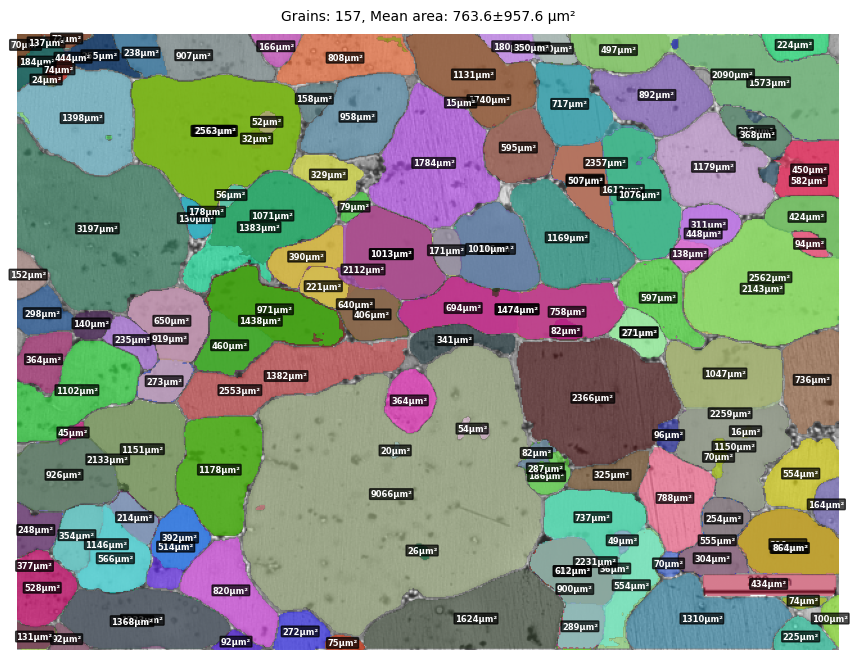


--- image0100 Analysis ---
Total grains: 157
Mean area: 763.6 ± 957.6 μm²
Area range: 15.0 - 9066.0 μm²
Mean diameter: 27.1 ± 15.5 μm
Grain data saved: /content/masked_n1/image0100_grain_data.csv


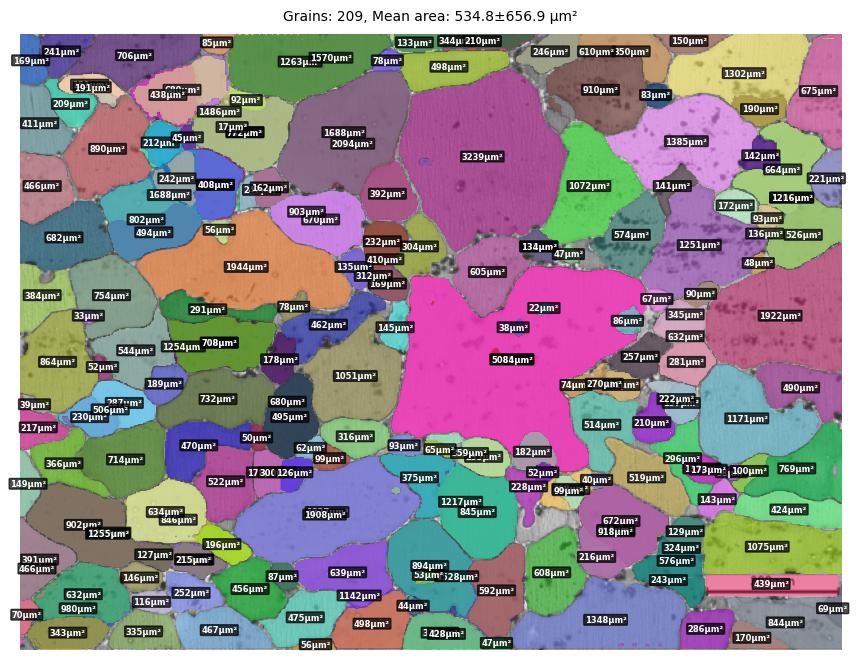


--- image0090 Analysis ---
Total grains: 209
Mean area: 534.8 ± 656.9 μm²
Area range: 16.8 - 5084.8 μm²
Mean diameter: 22.9 ± 12.4 μm
Grain data saved: /content/masked_n1/image0090_grain_data.csv

Processing batch 8: 4 images


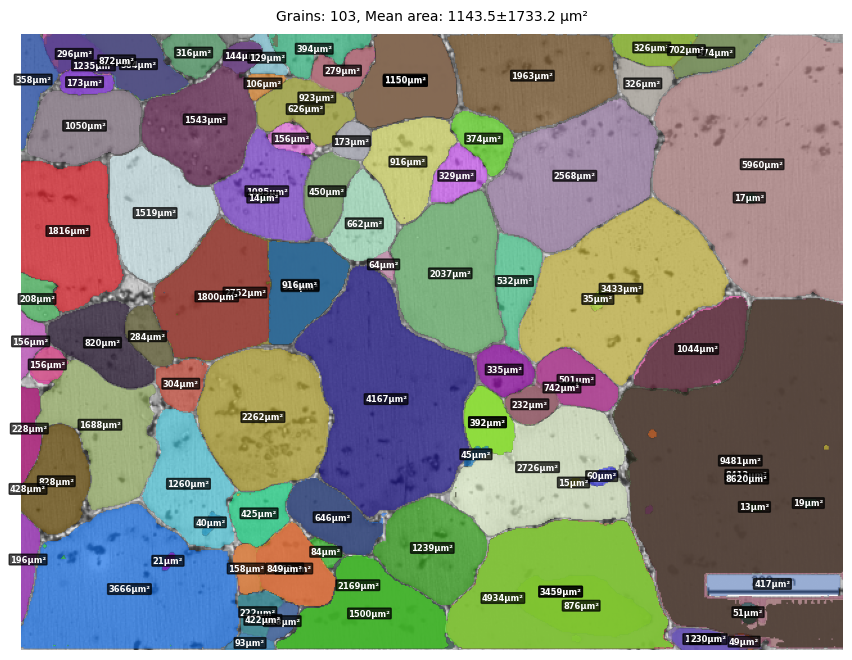


--- image0082 Analysis ---
Total grains: 103
Mean area: 1143.5 ± 1733.2 μm²
Area range: 13.2 - 9481.0 μm²
Mean diameter: 31.1 ± 22.1 μm
Grain data saved: /content/masked_n1/image0082_grain_data.csv


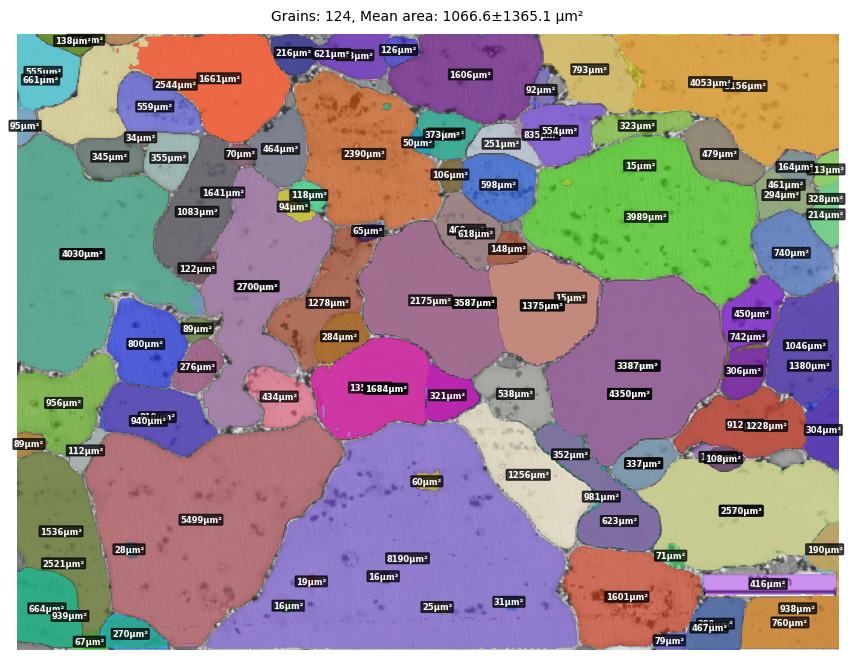


--- image0077 Analysis ---
Total grains: 124
Mean area: 1066.6 ± 1365.1 μm²
Area range: 15.2 - 8189.5 μm²
Mean diameter: 30.7 ± 20.5 μm
Grain data saved: /content/masked_n1/image0077_grain_data.csv


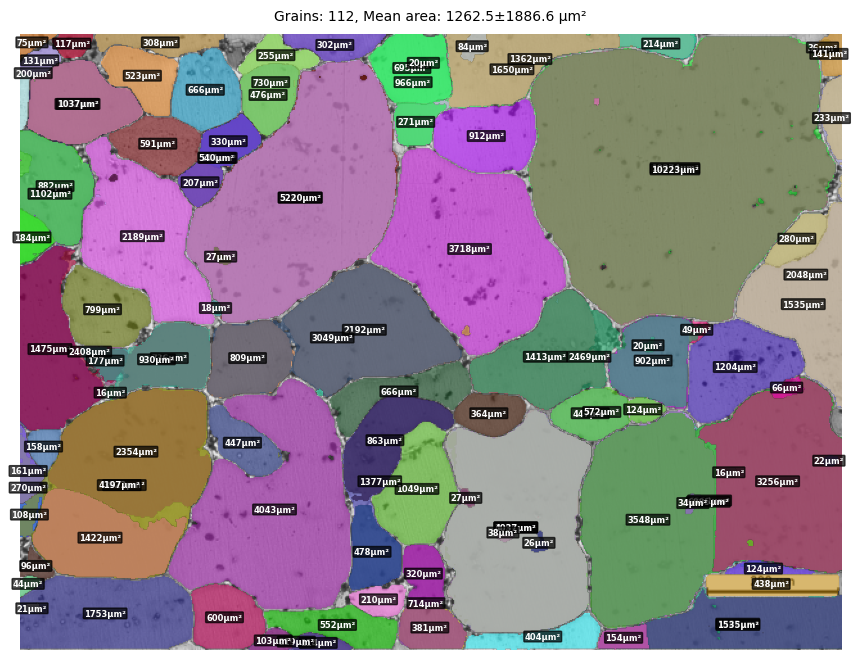


--- image0073 Analysis ---
Total grains: 112
Mean area: 1262.5 ± 1886.6 μm²
Area range: 16.0 - 10274.2 μm²
Mean diameter: 32.1 ± 24.1 μm
Grain data saved: /content/masked_n1/image0073_grain_data.csv


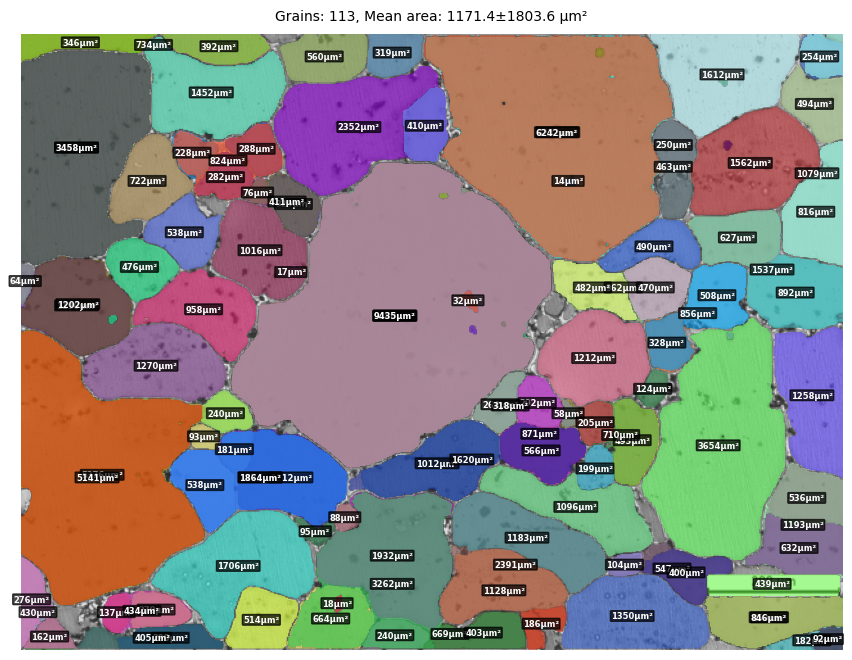


--- image0070 Analysis ---
Total grains: 113
Mean area: 1171.4 ± 1803.6 μm²
Area range: 13.8 - 9480.0 μm²
Mean diameter: 32.2 ± 21.3 μm
Grain data saved: /content/masked_n1/image0070_grain_data.csv

Processing batch 9: 4 images


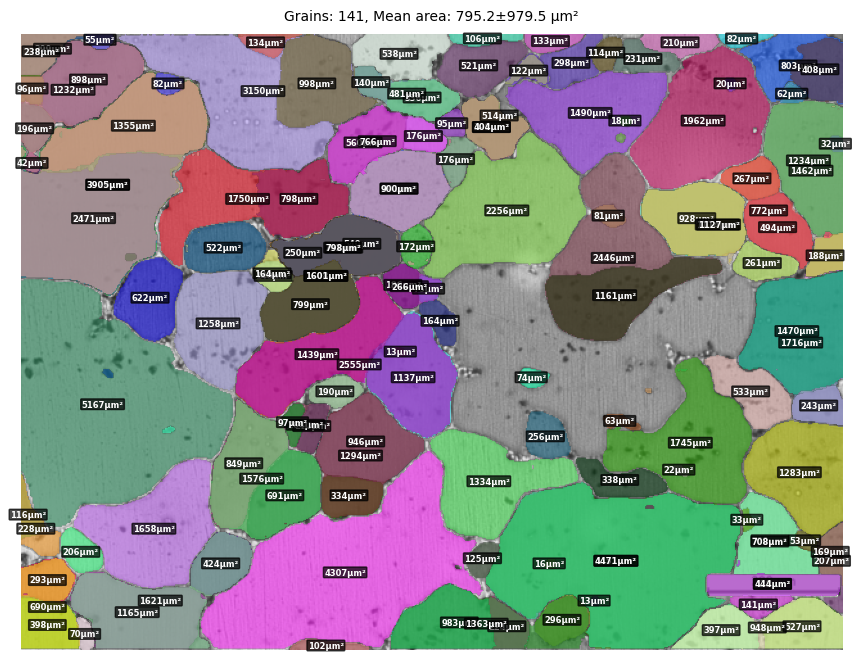


--- image0088 Analysis ---
Total grains: 141
Mean area: 795.2 ± 979.5 μm²
Area range: 13.0 - 5167.2 μm²
Mean diameter: 27.1 ± 16.7 μm
Grain data saved: /content/masked_n1/image0088_grain_data.csv


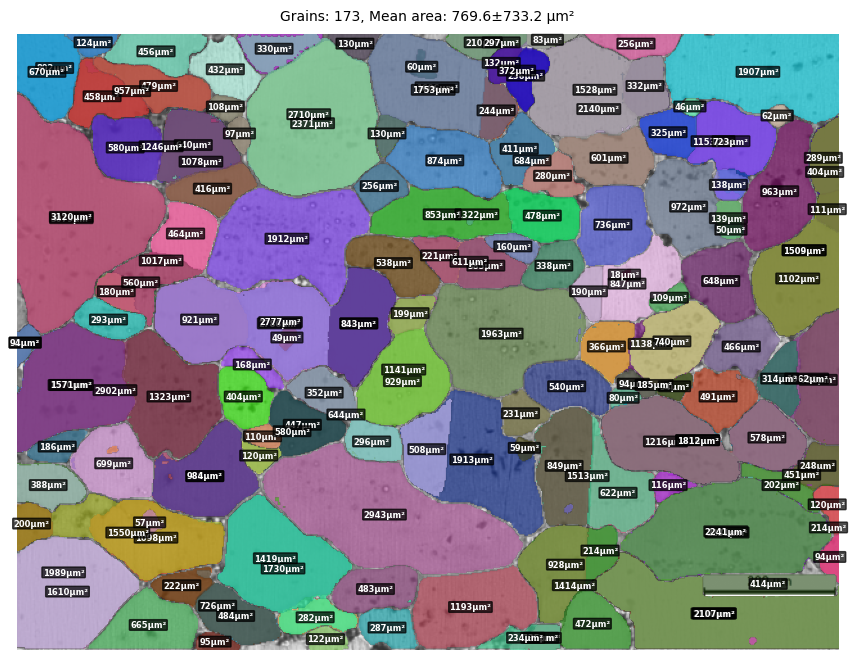


--- image0042 Analysis ---
Total grains: 173
Mean area: 769.6 ± 733.2 μm²
Area range: 18.5 - 3119.5 μm²
Mean diameter: 27.9 ± 14.1 μm
Grain data saved: /content/masked_n1/image0042_grain_data.csv


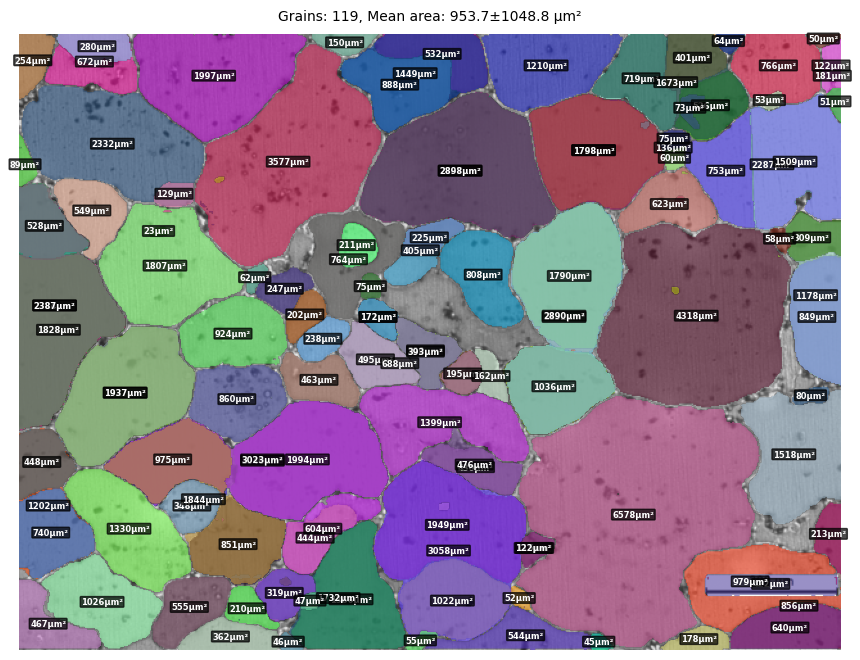


--- image0061 Analysis ---
Total grains: 119
Mean area: 953.7 ± 1048.8 μm²
Area range: 22.8 - 6578.5 μm²
Mean diameter: 30.2 ± 17.4 μm
Grain data saved: /content/masked_n1/image0061_grain_data.csv


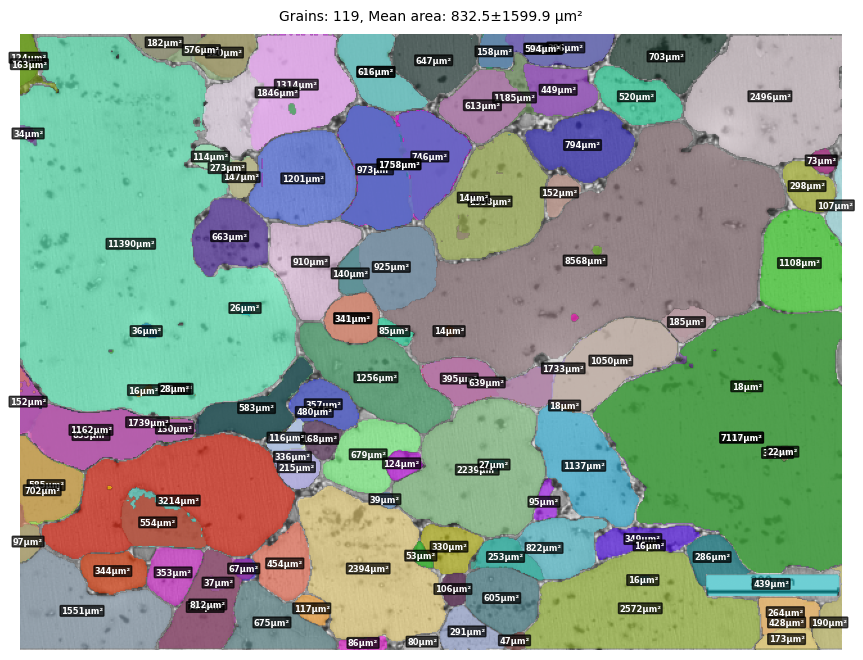


--- image0078 Analysis ---
Total grains: 119
Mean area: 832.5 ± 1599.9 μm²
Area range: 13.8 - 11389.5 μm²
Mean diameter: 25.7 ± 20.0 μm
Grain data saved: /content/masked_n1/image0078_grain_data.csv

Processing batch 10: 4 images


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


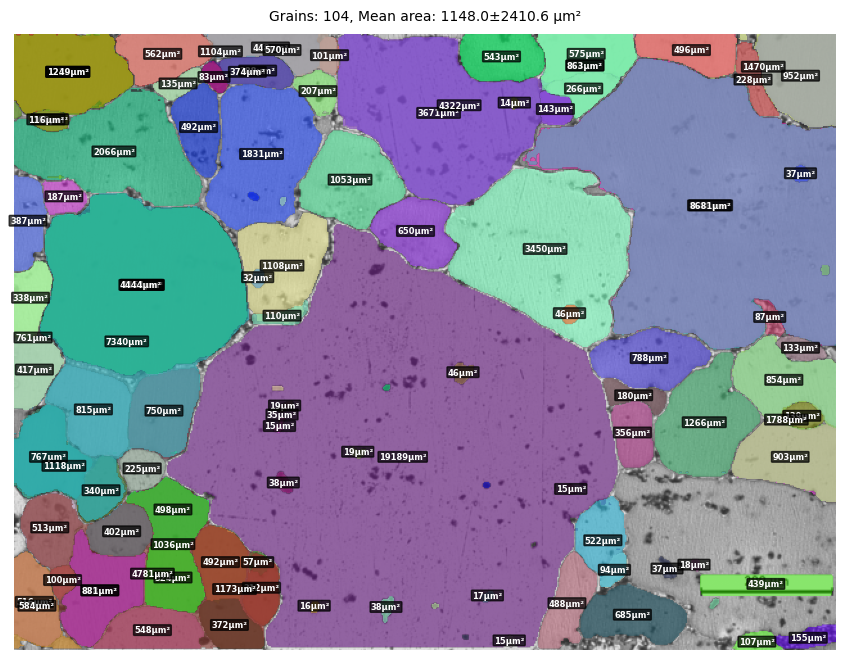


--- image0096 Analysis ---
Total grains: 104
Mean area: 1148.0 ± 2410.6 μm²
Area range: 13.5 - 19189.0 μm²
Mean diameter: 29.1 ± 24.8 μm
Grain data saved: /content/masked_n1/image0096_grain_data.csv


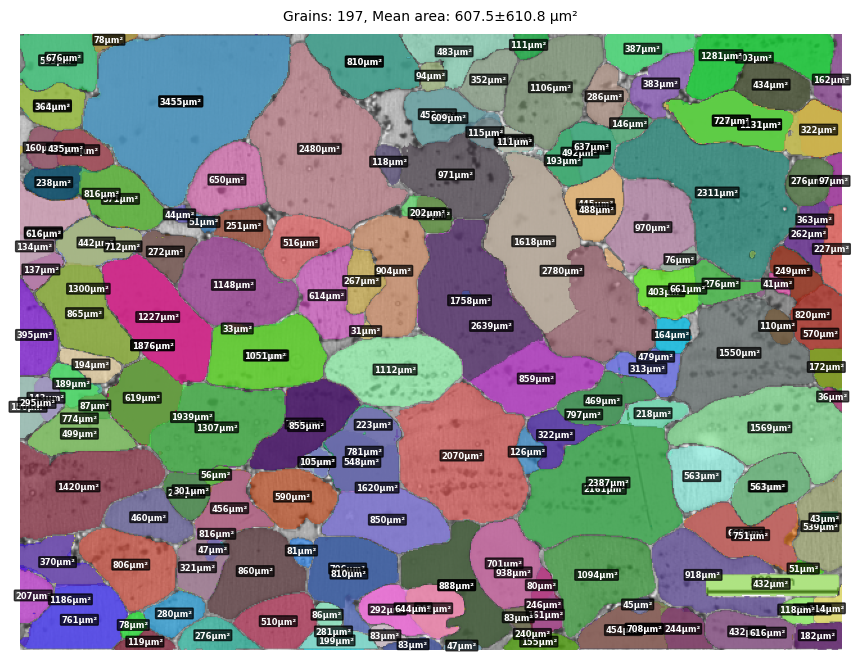


--- image0055 Analysis ---
Total grains: 197
Mean area: 607.5 ± 610.8 μm²
Area range: 30.8 - 3454.8 μm²
Mean diameter: 24.9 ± 12.4 μm
Grain data saved: /content/masked_n1/image0055_grain_data.csv


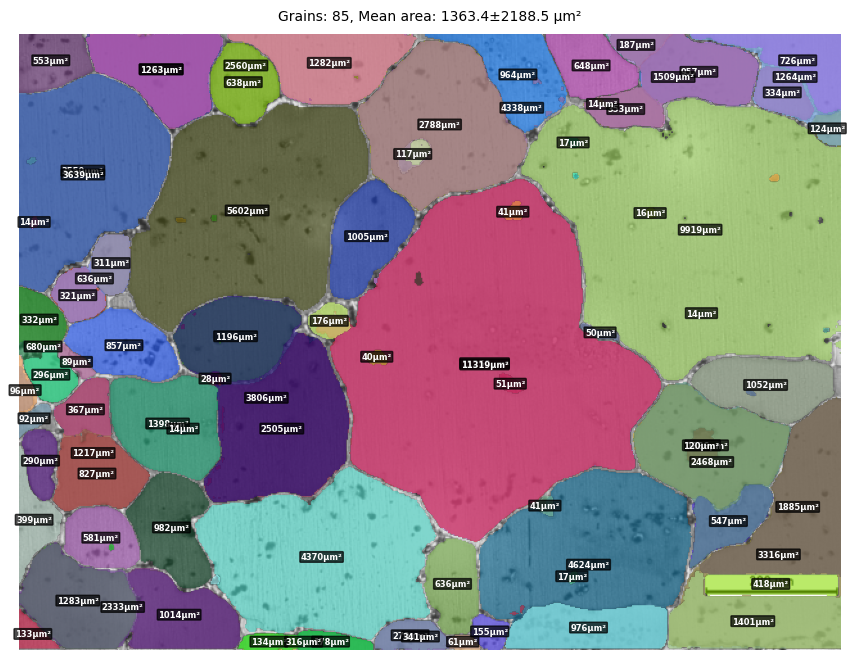


--- image0085 Analysis ---
Total grains: 85
Mean area: 1363.4 ± 2188.5 μm²
Area range: 13.5 - 11318.8 μm²
Mean diameter: 32.9 ± 25.6 μm
Grain data saved: /content/masked_n1/image0085_grain_data.csv


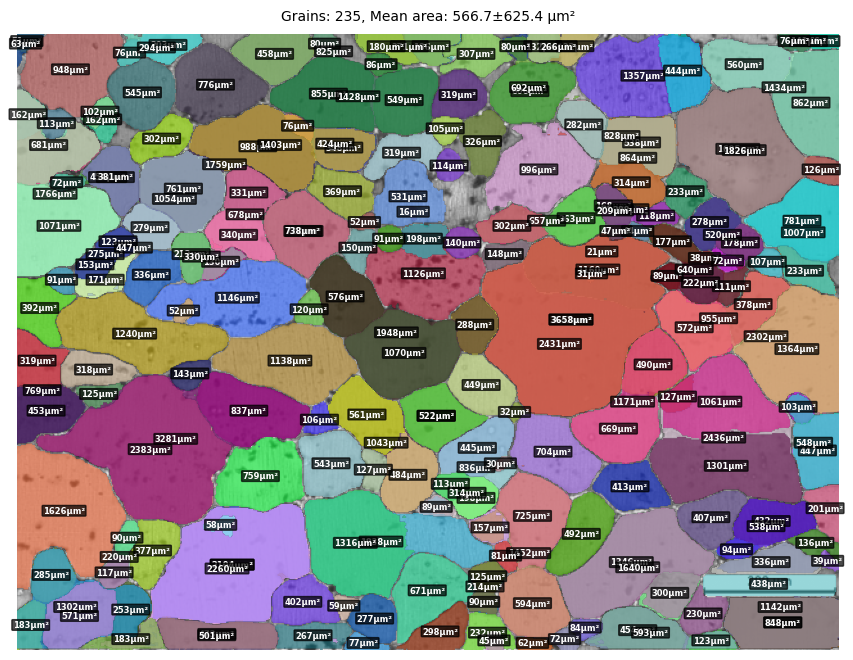


--- image0056 Analysis ---
Total grains: 235
Mean area: 566.7 ± 625.4 μm²
Area range: 16.5 - 3657.5 μm²
Mean diameter: 23.6 ± 12.8 μm
Grain data saved: /content/masked_n1/image0056_grain_data.csv

Processing batch 11: 4 images


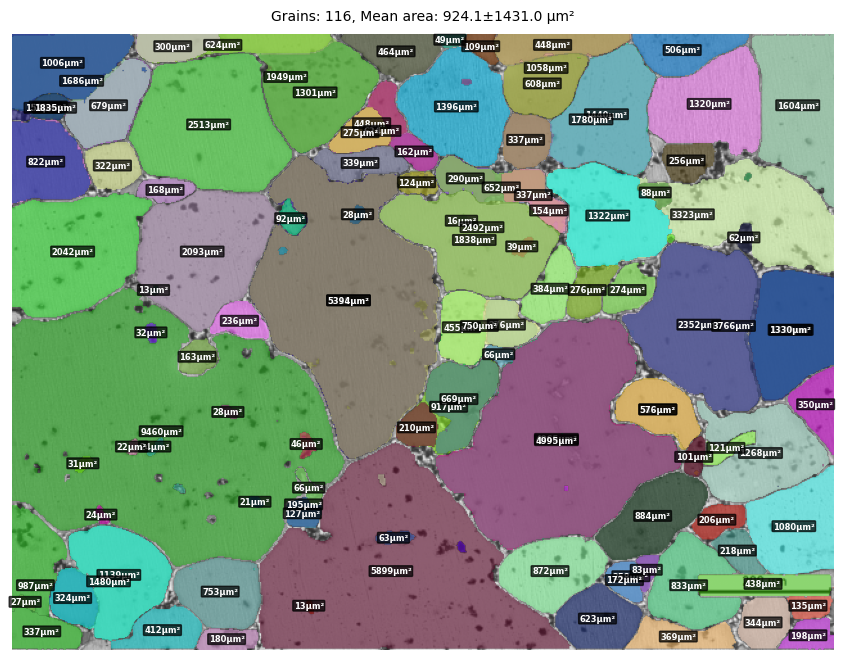


--- image0075 Analysis ---
Total grains: 116
Mean area: 924.1 ± 1431.0 μm²
Area range: 13.2 - 9460.5 μm²
Mean diameter: 27.7 ± 20.2 μm
Grain data saved: /content/masked_n1/image0075_grain_data.csv


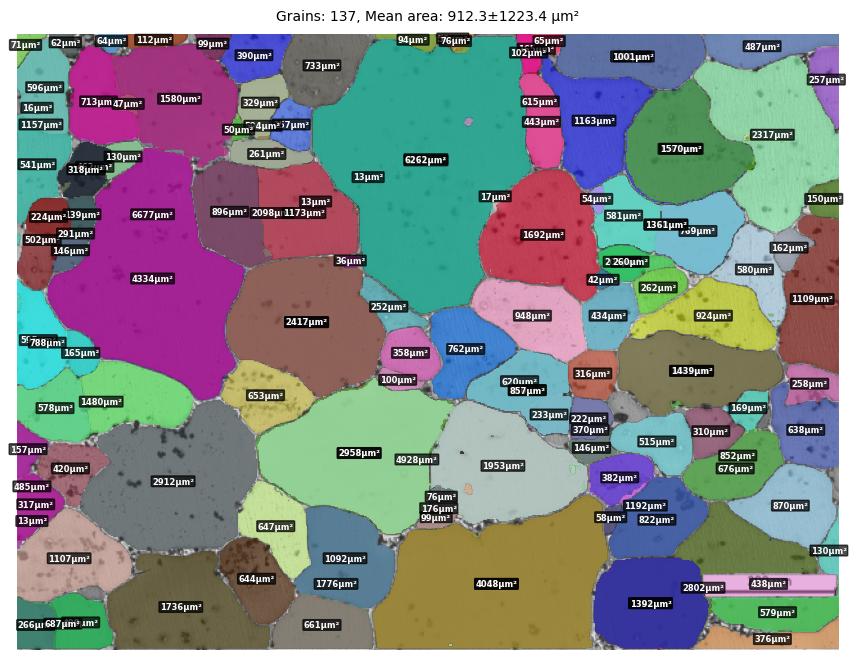


--- image0071 Analysis ---
Total grains: 137
Mean area: 912.3 ± 1223.4 μm²
Area range: 13.0 - 6677.0 μm²
Mean diameter: 28.7 ± 18.3 μm
Grain data saved: /content/masked_n1/image0071_grain_data.csv


Exception ignored in: <function _xla_gc_callback at 0x7d9add54ba60>
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/jax/_src/lib/__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
    
KeyboardInterrupt: 


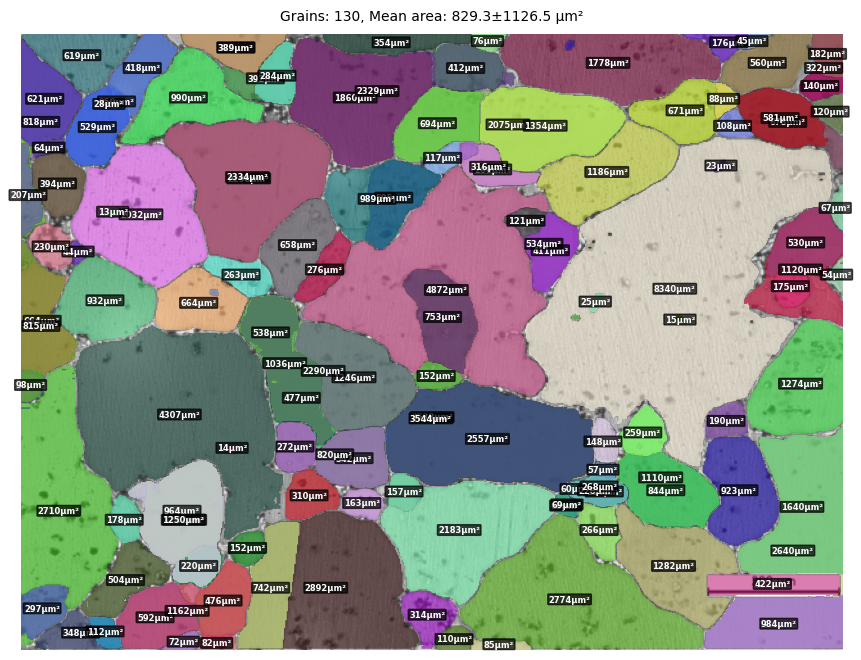


--- image0051 Analysis ---
Total grains: 130
Mean area: 829.3 ± 1126.5 μm²
Area range: 13.0 - 8340.5 μm²
Mean diameter: 27.4 ± 17.5 μm
Grain data saved: /content/masked_n1/image0051_grain_data.csv


KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x7d9c29141300> (for post_execute):


KeyboardInterrupt: 

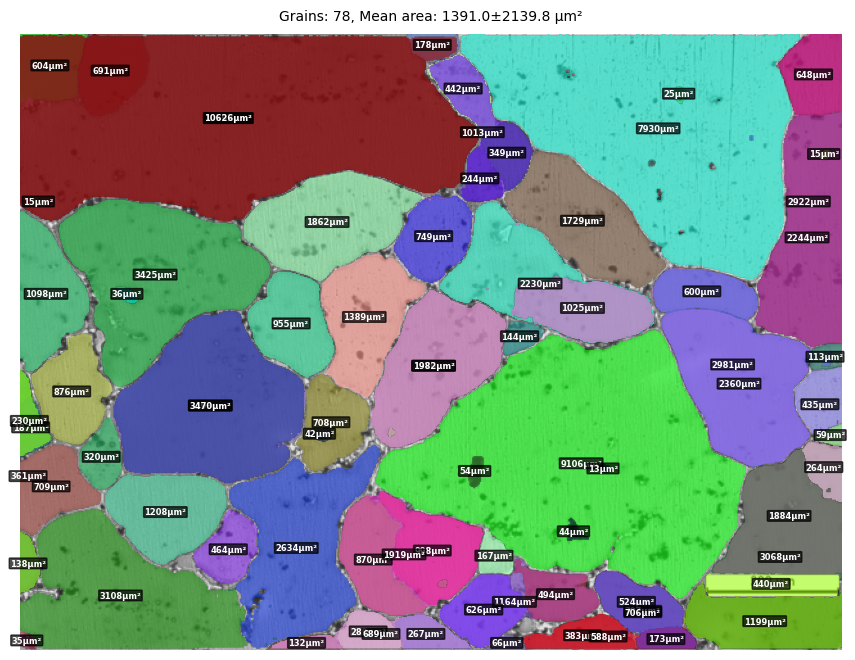

In [ ]:
from PIL import Image
import gc
from imutils import paths
import os

# omit with your path
if not os.path.exists('/content/masked_n1'):
    os.makedirs('/content/masked_n1')

image_paths = list(paths.list_images('/content/data/')) # omit with your path

batch_size = 4

all_results = []

print(f"Processing {len(image_paths)} images with pixel size: {PIXEL_SIZE_UM} μm/pixel")
print("=" * 60)

for i in range(0, len(image_paths), batch_size):
    batch_paths = image_paths[i:i+batch_size]
    print(f"\nProcessing batch {i//batch_size + 1}: {len(batch_paths)} images")

    batch_images = []
    for imagepath in batch_paths:
        raw_image = Image.open(imagepath).convert("RGB")
        new_image = raw_image.resize((640, 480))
        batch_images.append(new_image)

    outputs = generator(batch_images, points_per_batch=64)

    for imagepath, new_image, output in zip(batch_paths, batch_images, outputs):
        masks = output["masks"]
        grain_data, stats = show_masks_on_image(new_image, masks, imagepath)

        result = {
            'image_name': os.path.basename(imagepath),
            'grain_data': grain_data,
            'stats': stats
        }
        all_results.append(result)

    gc.collect()


In [ ]:
print("\n" + "=" * 60)
print("BATCH SUMMARY")
print("=" * 60)

all_grain_data = []
image_summaries = []

for result in all_results:
    if result['grain_data']:
        for grain in result['grain_data']:
            grain_with_image = grain.copy()
            grain_with_image['image_name'] = result['image_name']
            all_grain_data.append(grain_with_image)

        stats = result['stats']
        image_summaries.append({
            'image_name': result['image_name'],
            'num_grains': stats['total_grains'],
            'mean_area_um2': stats['mean_area_um2'],
            'total_area_um2': stats['total_area_um2']
        })

if all_grain_data:
    all_df = pd.DataFrame(all_grain_data)
    all_df.to_csv('/content/masked_n1/ALL_GRAINS_COMBINED.csv', index=False)

    summary_df = pd.DataFrame(image_summaries)
    summary_df.to_csv('/content/masked_n1/IMAGE_SUMMARIES.csv', index=False)

    all_areas = all_df['area_um2'].values
    print(f"OVERALL STATISTICS:")
    print(f"Total images processed: {len(all_results)}")
    print(f"Total grains found: {len(all_grain_data)}")
    print(f"Overall mean area: {np.mean(all_areas):.1f} ± {np.std(all_areas):.1f} μm²")
    print(f"Overall area range: {np.min(all_areas):.1f} - {np.max(all_areas):.1f} μm²")
    print(f"Median area: {np.median(all_areas):.1f} μm²")

    print(f"\nFiles saved:")
    print(f"- Individual images with areas: /content/masked_n1/*_with_areas.png")
    print(f"- Individual grain data: /content/masked_n1/*_grain_data.csv")
    print(f"- Combined grain data: /content/masked_n1/ALL_GRAINS_COMBINED.csv")
    print(f"- Image summaries: /content/masked_n1/IMAGE_SUMMARIES.csv")

print(f"\nDone! Check /content/masked/ folder for results.")


BATCH SUMMARY
OVERALL STATISTICS:
Total images processed: 43
Total grains found: 6264
Overall mean area: 864.7 ± 1558.7 μm²
Overall area range: 12.8 - 71826.5 μm²
Median area: 442.9 μm²

Files saved:
- Individual images with areas: /content/masked_n1/*_with_areas.png
- Individual grain data: /content/masked_n1/*_grain_data.csv
- Combined grain data: /content/masked_n1/ALL_GRAINS_COMBINED.csv
- Image summaries: /content/masked_n1/IMAGE_SUMMARIES.csv

Done! Check /content/masked/ folder for results.


### **You can run the cell below to download the image output**

In [ ]:
!zip -r /content/file.zip /output_image_path/